
**Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones**

**Edición 2022**

# Grupo 8

**Integrantes:**

* Abdala, Agustin
* Acosta, Martín
* Baulina, David
* Giovine, Carina

---
## Trabajo práctico entregable - Parte 1

In [ ]:
!pip install geopandas
!pip install folium
!wget https://infra.datos.gob.ar/catalog/modernizacion/dataset/7/distribution/7.12/download/provincias.geojson -o provincias.json
#!wget https://drive.google.com/file/d/1xraHmo5h01oQEYxL6Nm1hfEseOhNNwKW/view?usp=sharing -o provinciasArgentina.geojson

import folium
import io
import matplotlib
import matplotlib.pyplot as plt
import numpy
import pandas as pd
import seaborn
import geopandas as gpd

from scipy.stats import variation
from google.colab import files

seaborn.set_context('talk')

     |████████████████████████████████| 1.0 MB 8.1 MB/s 
     |████████████████████████████████| 6.3 MB 41.2 MB/s 
     |████████████████████████████████| 16.7 MB 352 kB/s 


## Lectura del dataset

En la notebook 00 se explican los detalles de la siguiente sección.

In [ ]:
url = 'https://cs.famaf.unc.edu.ar/~mteruel/datasets/diplodatos/sysarmy_survey_2020_processed.csv'
df = pd.read_csv(url)

In [ ]:
df[:3]

,profile_gender,profile_age,work_country,work_province,profile_years_experience,work_years_in_company,work_years_in_current_position,work_people_in_charge_of,profile_studies_level,profile_studies_level_state,...,work_has_violence_situations,profile_sexual_orientation,profile_has_disabilities,profile_has_disabilities_hiring_difficulties,company_employee_number,company_main_activity,company_recommended,company_diversity_policies,company_extra_benefits,company_best_companies_city
0,Mujer,26,Argentina,Ciudad Autónoma de Buenos Aires,3.0,3.0,3.0,0,Universitario,En curso,...,En mi trabajo actual,Homosexual,NaN,NaN,501-1000,Servicios / Consultoría de Software / Digital,7,2,"Capacitaciones y/o cursos, Comidas pagas / sub...",NaN
1,Hombre,29,Argentina,Corrientes,5.0,2.0,2.0,4,Universitario,En curso,...,Jamás,Heterosexual,Visual,No,201-500,Otras industrias,8,9,"Horarios flexibles, Stock options / RSUs, Viát...",NaN
2,Mujer,22,Argentina,Ciudad Autónoma de Buenos Aires,2.0,0.0,0.0,0,Secundario,Completado,...,En un trabajo anterior,Bisexual o queer,NaN,No,2001-5000,Otras industrias,6,9,"Clases de gimnasia online, Comidas pagas / sub...",NaN


# Ejercicio 1 - Análisis descriptivo

Responder a la pregunta: **¿Cuáles son los lenguajes de programación asociados a los mejores salarios?**

Para ello:
1. Seleccionar las columnas relevantes para analizar.
2. Seleccionar las filas relevantes para analizar. Esto incluye la eliminación de valores extremos y erróneos, pero también puede enfocar el análisis en una sub-población. Por ejemplo, se pueden limitar a personas con un salario mayor que 10000 pesos, o a las personas que trabajan sólo en "Data Science", pero deben justificar su elección y reformular la pregunta inicial de ser necesario.
  * Obtener una lista de los lenguajes de programación más populares. Decidir cuántos y cuáles seleccionan para incluir en el análisis.
  * Para cada una de las otras columnas del punto anterior, elegir los rangos o valores seleccionan para incluir en el análisis.
3. Seleccionar métricas que ayuden a responder la pregunta, y los métodos para analizarlas. Elegir UNA de las siguientes opciones:
  * Comparar las distribuciones de salario para cada lenguaje utilizando visualizaciones. Como la visualización es el producto final, debe ser clara y mostrar información relevante.
  * Comparar medidas de estadística descriptiva sobre la distribución de salario para cada lenguaje. Sean creativos, la estadística descriptiva nos permite decir cosas como: "el 10% de los mejores sueldos los ganan, en su mayoría, programadores que saben kotlin!" (donde *mayoría* es un término medio engañoso que sólo significa más del 50%). Para comparar múltiples lenguajes, les recomendamos usar también visualizaciones.
  * Comparar probabilidades. Por ejemplo: "Si sabés Python o Java, tenés un 30% más de chances de ganar arriba de 100K".

Si lo consideran necesario, realicen varias iteraciones. Es decir, si encuentran que las distribuciones de los lenguajes de programación que seleccionaron inicialmente no son muy diferentes, pueden re-hacer el análisis usando sólo los lenguajes de programación que son diferentes.

# Ejercicio 1 - Respuestas

## Pregunta 1

Para buscar las columnas relevantes se pide una descripción de las mismas

In [ ]:
df.columns

Index(['profile_gender', 'profile_age', 'work_country', 'work_province',
       'profile_years_experience', 'work_years_in_company',
       'work_years_in_current_position', 'work_people_in_charge_of',
       'profile_studies_level', 'profile_studies_level_state',
       'profile_career', 'profile_university',
       'profile_specialization_courses', 'profile_open_source_contributions',
       'profile_programming_as_hobby', 'work_role', 'tools_platform',
       'tools_programming_languages', 'tools_frameworks', 'tools_data_bases',
       'tools_qa_testing', 'tools_IDEs', 'tools_work_pc_os',
       'tools_cellphone_os', 'work_on_call_duty', 'salary_on_call_duty_charge',
       'work_on_call_duty_charge_type', 'work_contract_type',
       'salary_monthly_BRUTO', 'salary_monthly_NETO', 'salary_in_usd',
       'salary_satisfaction', 'salary_comparison_last_semester',
       'salary_has_bonus', 'salary_bonus_tied_to',
       'salary_inflation_adjustment_2020',
       'salary_percentage_inf

De esto se seleccionan las siguientes columnas relevantes:
* 'tools_progamming_languagues' 
* 'salary-monthly_NETO'
* 'profile_years_experience'
* 'work_province'
*   'profile_studies_level'


In [ ]:
# complete here if you want to include more columns
relevant_columns = ['tools_programming_languages', 'salary_monthly_NETO', 'profile_years_experience','work_province', 'profile_studies_level' ]

Decidimos elegir tools_programming_languages y salary-monthly_NETO porque consideramos que eran las que mas directamente respondian la pregunta formulada, es decir: con qué lenguaje de programación se gana mas en Argentina. Decidimos elegir los otros tres campos: profile_years_experience, work_province y profile_studies_level porque consideramos que podrían aportar mayor información sobre la evolución de los salarios con los distintos lenguajes: los años de experiencia en un oficio suelen ser determinantes en la remuneración obtenida, así como el lugar donde se ejerce (los sueldos en ciudades grandes suelen ser mayores a ciudades chicas) y el nivel de estudio (suele pagarse un extra por titulos profesionales incluso en areas donde no son requeridos). 



## Pregunta 2

## Lista de los lenguajes de programación relevantes
Consultar por filas relevantes, se consideraran los 5 lenguajes mas populares

### Conteo de frecuencias de los lenguajes de programación

La columna que contiene información sobre los lenguajes de programación utilizados es `tools_programming_languages`. Sus valores son strings con los lenguajes seleccionados separados por comas.



In [ ]:
df.tools_programming_languages[:3]

0                     Ninguno
1    HTML, Javascript, Python
2                     Ninguno
Name: tools_programming_languages, dtype: object

Las siguientes celdas de código separan estos lenguajes de programación y cuentan la frecuencia con la que aparecen.

In [ ]:
# Convert the comma-separated string of languages to a list of string.
# Remove 'ninguno de los anteriores' option, spaces and training commas.
def split_languages(languages_str):
  if not isinstance(languages_str, str):
    return []
  # Remove 'other' option
  languages_str = languages_str.lower()\
    .replace('ninguno de los anteriores', '')
  # Split string into list of items
  # Remove spaces and commas for each item
  return [lang.strip().replace(',', '')
          for lang in languages_str.split()]

# Create a new column with the list of languages
df.loc[:, 'cured_programming_languages'] = df.tools_programming_languages\
    .apply(split_languages)
if 'cured_programming_languages' not in relevant_columns:
    relevant_columns.append('cured_programming_languages') 

# Duplicate each row of df for each programming language
# mentioned in the response.
# We only include in df_lang the columns we are going to analyze later, so we
# don't duplicate innecesary information.
df_lang = df.cured_programming_languages\
    .apply(pd.Series).stack()\
    .reset_index(level=-1, drop=True).to_frame()\
    .join(df[relevant_columns])\
    .rename(columns={0: 'programming_language'})
# Horrible programming style! But a lot of data science code can be written with
# as concatenations of functions (pipelines), and there's no elegant way of
# doing that on Python.
df_lang[:5]

,programming_language,tools_programming_languages,salary_monthly_NETO,profile_years_experience,work_province,profile_studies_level,cured_programming_languages
0,ninguno,Ninguno,43000.0,3.0,Ciudad Autónoma de Buenos Aires,Universitario,[ninguno]
1,html,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,javascript,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,python,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
2,ninguno,Ninguno,127000.0,2.0,Ciudad Autónoma de Buenos Aires,Secundario,[ninguno]


En la columna `programming_language` se encuentra cada lenguaje por separado. Notar que si una respuesta contenía 3 lenguajes, como `"HTML, Javascript, Python"`, la fila ha sido replicada 3 veces. Por ello, hay tres filas con índice 1.

In [ ]:
language_count = df_lang.programming_language.value_counts()\
    .reset_index()\
    .rename(columns={'index': 'language', 'programming_language': 'frequency'})

language_count[:10]

,language,frequency
0,javascript,2513
1,sql,2154
2,html,1861
3,python,1475
4,java,1453
5,css,1247
6,bash/shell,993
7,php,891
8,.net,823
9,typescript,779


In [ ]:
total_freq = language_count.frequency.sum()
first5_freq = language_count[:5].frequency.sum()

print("Suma de frecuencias de todos los lenguajes: ", total_freq)
print("Suma de frecuencias de 5 lenguajes mas utilizados: ", first5_freq)
print("La frecuencia de los 5  primeros lenguajes supera el %50 del total, es: %", (first5_freq / total_freq)*100)

Suma de frecuencias de todos los lenguajes:  18000
Suma de frecuencias de 5 lenguajes mas utilizados:  9456
La frecuencia de los 5  primeros lenguajes supera el %50 del total, es: % 52.53333333333333


Se seleccionan para el análisis los lenguajes: 'javascript', 'sql', 'html', 'python', 'java'.

### Filtrado de lenguajes relevantes

El siguiente código permite seleccionar sólo las filas donde el valor de la columna `programming_language` se encuentre en la lista `interesting_languages`.

In [ ]:
# Filter out languages that we want to exclude
# Complete here with your selected list.
interesting_languages = ["python", 'javascript', 'sql', 'html', 'java']
filtered_df_lang = df_lang[df_lang.programming_language.isin(interesting_languages)]
filtered_df_lang[:5]

,programming_language,tools_programming_languages,salary_monthly_NETO,profile_years_experience,work_province,profile_studies_level,cured_programming_languages
1,html,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,javascript,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,python,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
3,html,"Bash/Shell, C, CSS, HTML, Java, Javascript, PH...",102000.0,15.0,Corrientes,Posgrado,"[bash/shell, c, css, html, java, javascript, p..."
3,java,"Bash/Shell, C, CSS, HTML, Java, Javascript, PH...",102000.0,15.0,Corrientes,Posgrado,"[bash/shell, c, css, html, java, javascript, p..."


## Seleccion de rangos de columnas para analisis
Se filtraran los siguientes datos:


1.   Valores nulos en columna 'salary_monthly_NETO'
2.   Valores mayores a 31 años en 'profile_years_experience' 
3.   Outliers en columna 'salary_monthly_NETO' (2.5 q3)



Filtrado de valores nulos en columna 'salary_monthly_NETO'

In [ ]:
df_lang.head()

,programming_language,tools_programming_languages,salary_monthly_NETO,profile_years_experience,work_province,profile_studies_level,cured_programming_languages
0,ninguno,Ninguno,43000.0,3.0,Ciudad Autónoma de Buenos Aires,Universitario,[ninguno]
1,html,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,javascript,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
1,python,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
2,ninguno,Ninguno,127000.0,2.0,Ciudad Autónoma de Buenos Aires,Secundario,[ninguno]


In [ ]:
#Descartando NaN en salarios
df_draft = filtered_df_lang[filtered_df_lang['salary_monthly_NETO'].notnull()]
#Filtrando años de experiencia <50, hay algunos irracionales
df_draft= df_draft.reindex()

Filtrado outliers en columna 'salary_monthly_NETO' (2.5 q3)

In [ ]:
k = 90
percentile_90 = df_draft['salary_monthly_NETO'].quantile(k / 100)
n_below = len(df_draft[df_draft['salary_monthly_NETO'] < percentile_90])
n_above = len(df_draft[df_draft['salary_monthly_NETO'] > percentile_90])
print('Percentil {} de la columna {}: {}'.format(k, 'salary_monthly_NETO', percentile_90))
print('% de datos menor que percentil {}: {}'.format(k, n_below / len(df)))
print('% de datos mayor que percentil {}: {}'.format(k, n_above / len(df)))

Percentil 90 de la columna salary_monthly_NETO: 164899.99999999965
% de datos menor que percentil 90: 1.3453650533223953
% de datos mayor que percentil 90: 0.14963084495488105


Valores del ultimo decil de la muestra

In [ ]:
df_draft['salary_monthly_NETO'].quantile([.91, .92, .93, .94, .95, .98, .99, .995, .998])

0.910    170000.00
0.920    180000.00
0.930    195000.00
0.940    200000.00
0.950    240000.00
0.980    377344.62
0.990    475000.00
0.995    600000.00
0.998    900000.00
Name: salary_monthly_NETO, dtype: float64

In [ ]:
# Funcion para limitar los boxes segun rango intercuartilico
def clean_outliers_q3(dataset, column_name):
    """Returns dataset removing the outlier rows from column @column_name."""
    interesting_col = dataset[column_name]
    # Here we can remove the outliers from both ends, or even add more restrictions.
    mask_outlier = (interesting_col <= (2.5 * interesting_col.quantile(.75)))
    return dataset[mask_outlier]

Filtrado de valores mayores a 31 años en 'profile_years_experience' 

In [ ]:
#Agrupar por años de exp
experiencia = df_draft.groupby(by=['programming_language']).mean()
#experiencia = experiencia['salary_monthly_NETO'].round(decimals = 2).to_frame()
experiencia


,salary_monthly_NETO,profile_years_experience
programming_language,,
html,91807.318308,8.304796
java,99769.704651,8.818149
javascript,100349.853843,7.754213
python,110805.045791,9.357728
sql,92165.221091,8.911925


In [ ]:
# HTML creado en    1993
# JS creado en      1995
# Python creado en  1991
# JAVA creado en    1995
# SQL cresado en    1989

#Recortando años de experiencia a 31
df_draft = df_draft[(df_draft['profile_years_experience']<31)]


Se decide no tomar en cuenta aquellos perfiles con mas de 31 años de experiencia ya que exceden la antigüedad de cualquiera de los lenguajes seleccionados.

## Pregunta 3

##Comparacion de las distribuciones de salario para cada lenguaje
Se realiza un gráfico *boxenplot* para visualizar lenguajes de programacion vs salarios Netos

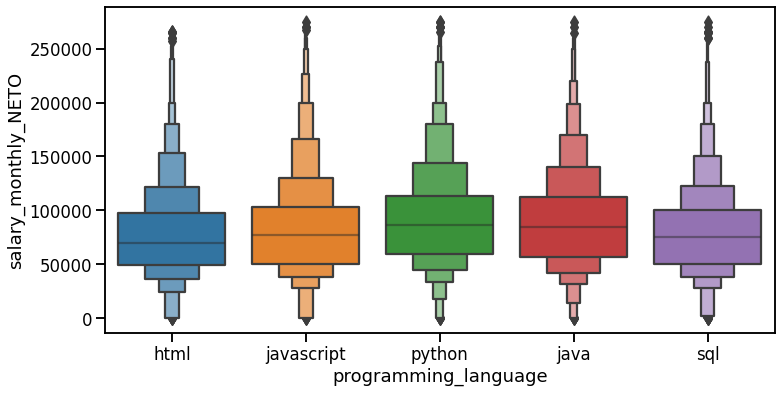

In [ ]:
plt.figure(figsize=(12, 6))
seaborn.boxenplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), y='salary_monthly_NETO', x='programming_language')
plt.ticklabel_format(style='plain', axis='y')


Como observamos en el gráfico superior, los lenguajes de *Python* y *Java*, a través de la mediana, o sea el valor central de todo el conjunto de datos, indica que el 50% de los valores están por encima de ese salario neto mensual.


En la tabla siguiente y a través del método *decribe()* se calcularán estadísticas de resumen en las variables numéricas del dataframe.

In [ ]:
data_limpia = clean_outliers_q3(df_draft, 'salary_monthly_NETO')
data_limpia.groupby(by='programming_language').describe()


salary_monthly_NETO                                   \
                                   count          mean           std  min   
programming_language                                                        
html                              1715.0  77176.574767  44142.095727  1.0   
java                              1356.0  89920.054597  46964.930617  1.0   
javascript                        2283.0  82554.289929  46873.570774  1.0   
python                            1339.0  92329.675046  47916.465769  1.0   
sql                               2009.0  80019.206391  42825.335573  1.0   

                                                            \
                          25%      50%       75%       max   
programming_language                                         
html                  48935.0  70000.0   97750.0  265000.0   
java                  56875.0  85000.0  112000.0  275000.0   
javascript            50000.0  77000.0  103000.0  275000.0   
python                60000.0  86000.0  113500.0  275000.0   
sql                   50000.0  75000.0  100000.0  275000.0   

                     profile_years_experience                                \
                                        count      mean       std  min  25%   
programming_language                                                          
html                                   1715.0  8.002041  6.622810  0.0  3.0   
java                                   1356.0  8.400074  6.564811  0.0  3.0   
javascript                             2283.0  7.459439  6.264629  0.0  3.0   
python                                 1339.0  9.020836  6.890068  0.0  3.0   
sql                                    2009.0  8.542111  6.663963  0.0  3.0   

                                       
                      50%   75%   max  
programming_language                   
html                  6.0  12.0  30.0  
java                  7.0  12.0  30.0  
javascript            5.0  11.0  30.0  
python                8.0  14.0  30.0  
sql                   7.0  13.0  30.0

**Como se puede ver Python tiene mayor sueldo medio.**


En éste detalle observamos datos relevantes como los salarios promedios de éstos mismos lenguajes que son superiores al resto de los lenguajes del listado. Python con $ 92.329,68 y Java con $ 89.920,05.

Se indican datos como los valores mínimos y máximos del conjunto de datos en estudio, y los cuartiles.  Analizando estos últimos puedo decir que en le caso del lenguaje Python el 25% de salarios están por debajo de $60.000 (primer      cuartil), el  50 % (segundo cuartil)  de los salarios están por debajo de $ 86.000 y el 75% (tercer cuartil) de los datos están por debajo de $133.500.-


Visualización de sueldo neto en funcion de los años de experiencia y el lenguaje de programación 

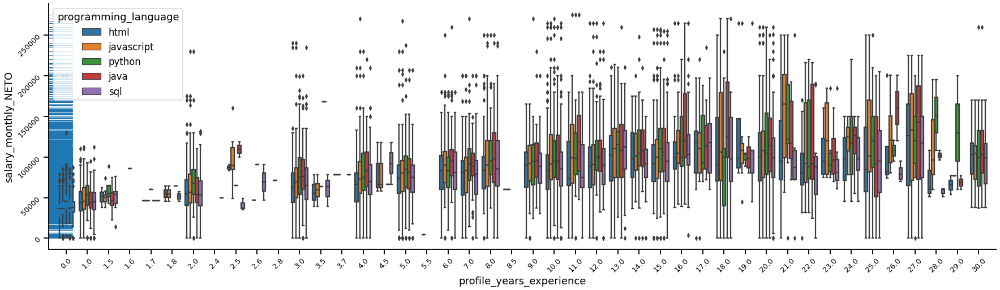

In [ ]:
# Graficando:
fig = plt.figure(figsize=(30, 8))
seaborn.boxplot(data= clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), x='profile_years_experience', y='salary_monthly_NETO', hue='programming_language' ).tick_params(labelsize=13, rotation=45)
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()


Visualización de sueldo neto en funcion del nivel de estudio y el lenguaje de programación 

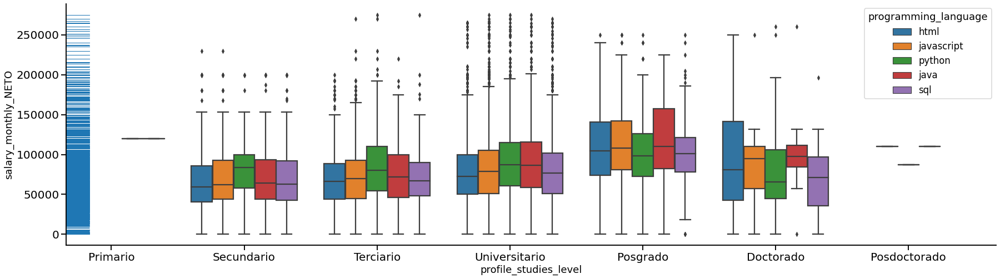

In [ ]:
# Graficando:
fig = plt.figure(figsize=(30, 8))
orden=['Primario', 'Secundario', 'Terciario', 'Universitario', 'Posgrado','Doctorado','Posdoctorado']
seaborn.boxplot(data= clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), x='profile_studies_level', y='salary_monthly_NETO', order = orden, hue='programming_language' ).tick_params(labelsize=20, rotation=0)
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()


Podemos observar que las medias de salarios por lenguaje van incrementandose por nivel de estudio alcanzado hasta el nivel de Doctorado, donde algunas medias bajan con respecto al nivel inmediatamente anterior (posgrado) y el nivel de dispersión es sensiblemente mayor.

Visualización de sueldo neto en funcion de la provincia y el lenguaje de programación

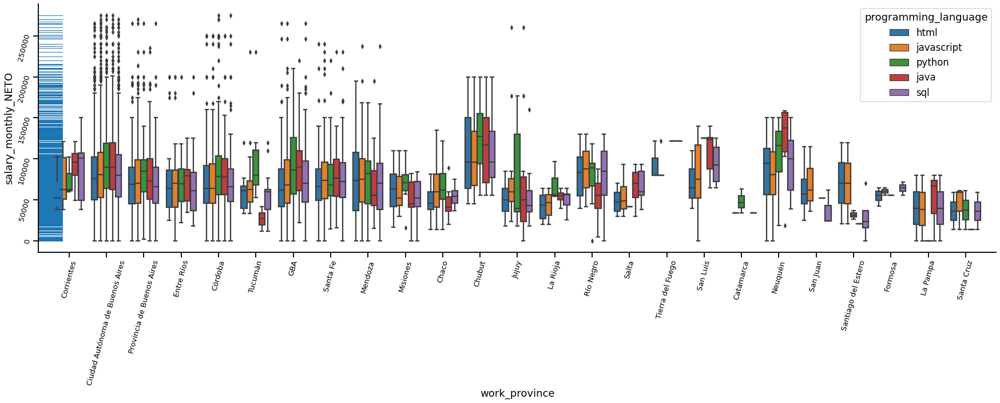

In [ ]:
# Graficando:
fig = plt.figure(figsize=(30, 8))
seaborn.boxplot(data= clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), x='work_province', y='salary_monthly_NETO',  hue='programming_language' ).tick_params(labelsize=13 , rotation=75)
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()


Los diagramas de caja por provincia en general se mantienen en rangos parecidos excepto las provincias de Chubut y Neuquen (con medias mas altas y mayor nivel de dispersión) y La Pampa y Santa Cruz, con medias mas bajas y menor nivel de dispersión. CABA, provincia de Buenos Aires y Córdoba poseen la mayor cantidad de outliers superando el tercer cuartil.

##Probabilidad de estar por encima de este sueldo medio


#### Cálculo del salario medio y la probabilidad de estar por encima de este sueldo medio

In [ ]:
df_clean=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO')


In [ ]:
avg_salary= df_clean['salary_monthly_NETO'].mean()
avg_salary

83561.12206297397

In [ ]:
prob_above_avg=len(df_clean[df_clean['salary_monthly_NETO']>=avg_salary])/len (df_clean)
prob_above_avg

0.4411629510457366

#### Calculo del salario medio y la probabilidad de estar por encima de este sueldo medio utilizando el lenguaje Python

In [ ]:
# Filter out languages that we want to exclude
# Complete here with your selected list.
interesting_languages = ["python"]
filtered_df0_lang = df_clean[df_clean.programming_language.isin(interesting_languages)]
filtered_df0_lang[:5]

,index,programming_language,tools_programming_languages,salary_monthly_NETO,profile_years_experience,work_province,profile_studies_level,cured_programming_languages
2,1,python,"HTML, Javascript, Python",63000.0,5.0,Corrientes,Universitario,"[html, javascript, python]"
6,3,python,"Bash/Shell, C, CSS, HTML, Java, Javascript, PH...",102000.0,15.0,Corrientes,Posgrado,"[bash/shell, c, css, html, java, javascript, p..."
17,9,python,"Assembler, Bash/Shell, C, C#, Python, R",39000.0,20.0,Ciudad Autónoma de Buenos Aires,Universitario,"[assembler, bash/shell, c, c#, python, r]"
20,10,python,"HTML, Javascript, Python",36800.0,1.0,Córdoba,Terciario,"[html, javascript, python]"
21,11,python,"Bash/Shell, Python",94621.0,15.0,Ciudad Autónoma de Buenos Aires,Universitario,"[bash/shell, python]"


In [ ]:
prob_above_avg_python=len(filtered_df0_lang[filtered_df0_lang['salary_monthly_NETO']>=avg_salary])/len (filtered_df0_lang)
prob_above_avg_python

0.5362210604929052

**Como se puede ver en el calculo anterior existe un 53% de posibilidades de ganar mas que la media si se en el trabajo se utiliza el lenguaje Python.** 

# Ejercicio 2 - Densidades y varias variables

Responder a la pregunta general: **¿Que herramientas (prácticas y teóricas) són útiles para explorar la base, descubrir patrones, asociaciones?**

Para ello considere (igual al ejercicio Anterior):
1. Seleccionar las columnas relevantes para analizar.
2. Seleccionar las filas relevantes para analizar. Esto incluye la eliminación de valores extremos y erróneos, pero también puede enfocar el análisis en sub-poblaciones. 

## a) Densidad conjunta

Que herramientas visuales y modelos puede utilizar para estudiar la distribución y comportamiento de sus datos? 

Elija tres variables numéricas y 2 variables categóricas. Visualice la base según varias de las variables elegidas. Puede describir de alguna forma el comportamiento de sus datos? Que herramientas utilizaría? Describa




## b) Asociación

* Necesitamos decidir si sacar o no la columna de salario bruto. Para hacer la encuesta más simple.
¿Existe una correlación entre el salario bruto y el neto? Que abordaje y medidas usaría



## c) Densidad condicional 

Estudie la distribución del salario según el nivel de estudio.

Separe la población según el nivel de estudio (elija dos subpoblaciones numerosas) y grafique de manera comparativa ambos histogramas de la variable `'salary_monthly_NETO'`
¿Considera que ambas variables son independientes?
¿Qué analizaría al respecto?

Calcule medidas de centralización y dispersión para cada subpoblación






# Ejercicio 2 - Respuestas

Las herramientas (prácticas y teóricas) són útiles para explorar la base, descubrir patrones, asociaciones son:

* Percentiles: permiten limpiar el dataframe de outliers o valores estadisticamente poco significativos.
* Media muestral: Nos da la idea del punto central de las desviaciones de los valores en una muestra.
* Diagramas de caja: Son utiles para comparar las medianas y los cuartiles de numerosas variables.
* Diagramas de dispersión: Sirve para identificar si existe o no una relacion entre dos variables cuantitativas.
* Coeficiente de correlación: Da una medida de la correlación de dos variables, con valores entre 1 y -1, siendo 1 correlacion absoluta entre ambas. Sirve para limpiar un dataframe de features que devuelven información similar.
* Densidad condicional: Nos permite comparar la distribucion de una variable, anclada a los valores de otra (numérica o categórica)

*   Herramientas de estadística descriptiva
*   Herramientas de estadítica inferencial
*   Herramientas graficas como:
              *   Histogramas
              *   Gráficos de dispersión
              *   Gráficos de caja


##1. Selección de las columnas relevantes para analizar

Para buscar las columnas relevantes se pide una descripción de las mismas

In [ ]:
# Enunciar columnas
df.columns

Index(['profile_gender', 'profile_age', 'work_country', 'work_province',
       'profile_years_experience', 'work_years_in_company',
       'work_years_in_current_position', 'work_people_in_charge_of',
       'profile_studies_level', 'profile_studies_level_state',
       'profile_career', 'profile_university',
       'profile_specialization_courses', 'profile_open_source_contributions',
       'profile_programming_as_hobby', 'work_role', 'tools_platform',
       'tools_programming_languages', 'tools_frameworks', 'tools_data_bases',
       'tools_qa_testing', 'tools_IDEs', 'tools_work_pc_os',
       'tools_cellphone_os', 'work_on_call_duty', 'salary_on_call_duty_charge',
       'work_on_call_duty_charge_type', 'work_contract_type',
       'salary_monthly_BRUTO', 'salary_monthly_NETO', 'salary_in_usd',
       'salary_satisfaction', 'salary_comparison_last_semester',
       'salary_has_bonus', 'salary_bonus_tied_to',
       'salary_inflation_adjustment_2020',
       'salary_percentage_inf

De esto se seleccionan las siguientes columnas relevantes:
* 'tools_progamming_languagues' 
* 'salary-monthly_NETO'
* 'profile_age'
* 'profile_years_experience'


In [ ]:
"""
Seleccionar columnas:
"""
relevant_columns = ['tools_programming_languages', 'salary_monthly_NETO', 'profile_age',  'profile_years_experience', ]

# Aplicar funcion para separar lenguages de programación agrupados en tools_programming_languages
df_ej2 = df.cured_programming_languages\
    .apply(pd.Series).stack()\
    .reset_index(level=-1, drop=True).to_frame()\
    .join(df[relevant_columns])\
    .rename(columns={0: 'programming_language'})
df_ej2.columns\
  

Index(['programming_language', 'tools_programming_languages',
       'salary_monthly_NETO', 'profile_age', 'profile_years_experience'],
      dtype='object')

In [ ]:
df_ej2

,programming_language,tools_programming_languages,salary_monthly_NETO,profile_age,profile_years_experience
0,ninguno,Ninguno,43000.0,26,3.0
1,html,"HTML, Javascript, Python",63000.0,29,5.0
1,javascript,"HTML, Javascript, Python",63000.0,29,5.0
1,python,"HTML, Javascript, Python",63000.0,29,5.0
2,ninguno,Ninguno,127000.0,22,2.0
...,...,...,...,...,...
6093,java,"C, C++, HTML, Java, Javascript, PHP, Python, SQL",72.0,28,5.0
6093,javascript,"C, C++, HTML, Java, Javascript, PHP, Python, SQL",72.0,28,5.0
6093,php,"C, C++, HTML, Java, Javascript, PHP, Python, SQL",72.0,28,5.0
6093,python,"C, C++, HTML, Java, Javascript, PHP, Python, SQL",72.0,28,5.0


## 2. Selección las filas relevantes para analizar.
 
1. Se agrupara por lenguajes de programación en 'programming_language'
2. Se filtraran Valores mayores a 64 años en 'profile_age'




In [ ]:
#Agrupamos por lenguaje y limpiamos
df_ej2.groupby(by='programming_language')
df_ej2['profile_age'].describe().astype(int)

#Filtrar edades ilógicas
df_ej2['profile_age'].max() #52000 años

filter_age = (df_ej2['profile_age'] < 65)
df_ej2 = df_ej2.loc[filter_age]
df_ej2['profile_age'].max() #64 años



64

In [ ]:
df_ej2['profile_age'].describe().astype(int)

count    17986
mean        32
std          7
min         18
25%         27
50%         31
75%         37
max         64
Name: profile_age, dtype: int64

## a) Densidad conjunta




**Variables numéricas:** 


* 'salary_monthly_NETO'

* 'work_years_in_company'

* 'profile_years_experience'




**Variables categóricas:**

* 'profile_gender'

* 'work_province'



In [ ]:
"""
Seleccionar columnas:
"""
relevant_columns = ['profile_gender', 'work_province', 'salary_monthly_NETO','work_years_in_company',  'profile_years_experience' ]

# Filtro por columnas relevantes
df_ej2a = df[relevant_columns]
df_ej2a.head()


,profile_gender,work_province,salary_monthly_NETO,work_years_in_company,profile_years_experience
0,Mujer,Ciudad Autónoma de Buenos Aires,43000.0,3.0,3.0
1,Hombre,Corrientes,63000.0,2.0,5.0
2,Mujer,Ciudad Autónoma de Buenos Aires,127000.0,0.0,2.0
3,Hombre,Corrientes,102000.0,15.0,15.0
4,Hombre,Ciudad Autónoma de Buenos Aires,106000.0,6.0,9.0


[(0.0, 50.0)]

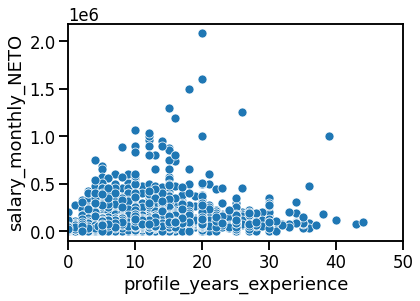

In [ ]:
seaborn.scatterplot(data = df_ej2a , x = 'profile_years_experience', y = 'salary_monthly_NETO').set(xlim=(0,50))

**Jointplot de densidad conjunta de variables numericas 'profile_years_experience' y 'salary_monthly_NETO'**

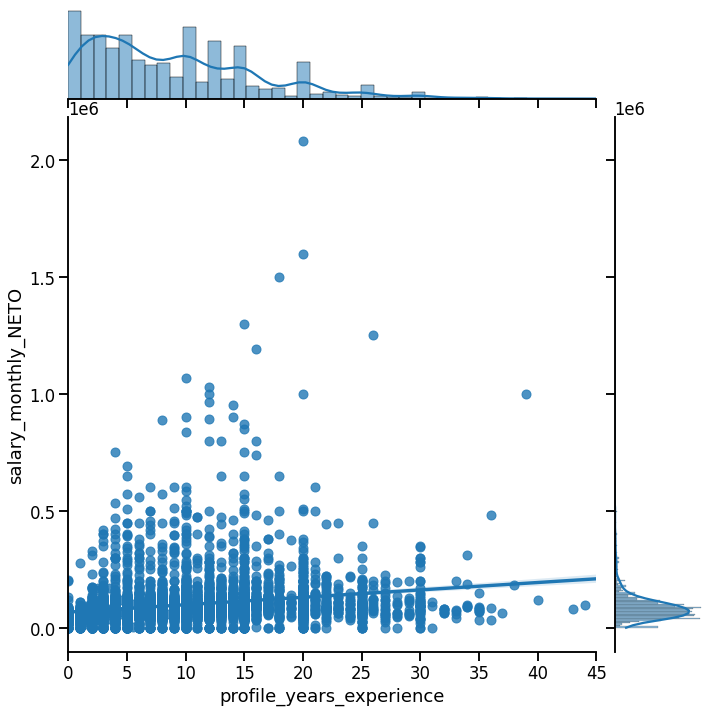

In [ ]:
plot = seaborn.jointplot(data = df_ej2a , x = 'profile_years_experience', y = 'salary_monthly_NETO', kind='reg', height=10)
plot.ax_marg_x.set_xlim(0, 45)
#plot.ax_marg_y.set_ylim(0, 1.5)
plt.show()

**Jointplot de densidad conjunta de variables numericas 'profile_years_experience' y 'salary_monthly_NETO' discriminadas por variable categorica: 'profile_gender**'

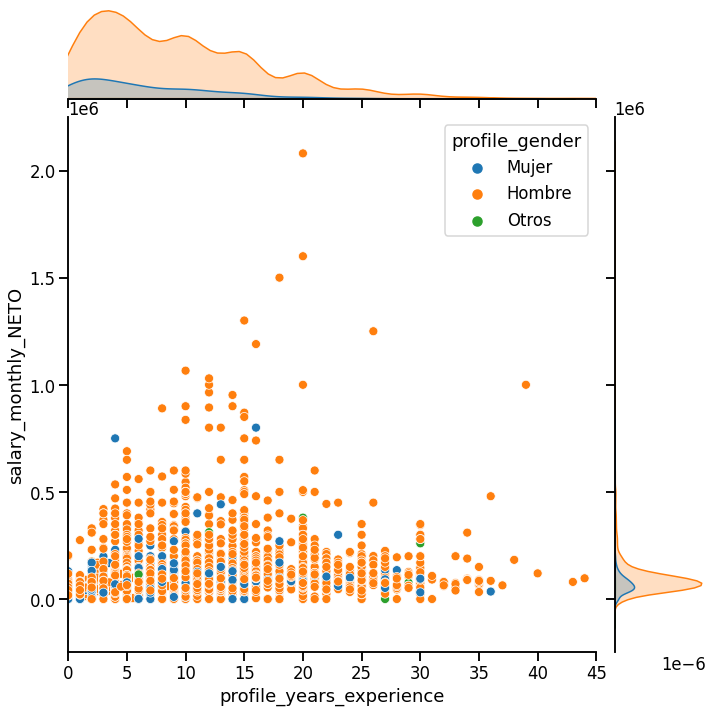

In [ ]:
plot = seaborn.jointplot(data = df_ej2a , x = 'profile_years_experience', y = 'salary_monthly_NETO', hue='profile_gender', height=10)
plot.ax_marg_x.set_xlim(0, 45)
plt.show()

**Jointplot de densidad conjunta de variables numericas 'profile_years_experience' y 'salary_monthly_NETO' discriminadas por variable categorica: 'work_province**'

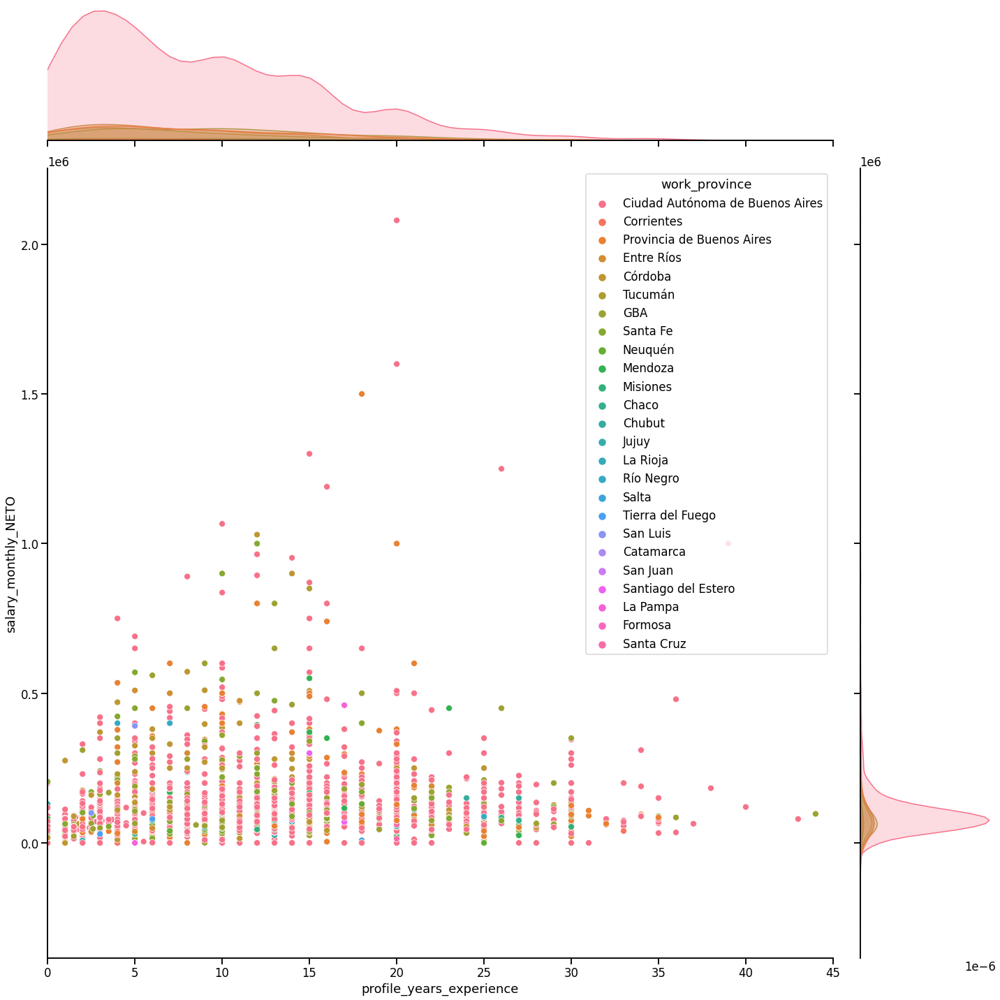

In [ ]:
plot = seaborn.jointplot(data = df_ej2a , x = 'profile_years_experience', y = 'salary_monthly_NETO', hue='work_province', height=20)
plot.ax_marg_x.set_xlim(0, 45)
#plot.ax_marg_y.set_ylim(0, 1.5)
plt.show()

In [ ]:
df_ej2a.groupby('work_province').describe()

salary_monthly_NETO                 \
                                              count           mean   
work_province                                                        
Catamarca                                       3.0   48133.333333   
Chaco                                          24.0   58424.125000   
Chubut                                         21.0   88841.619048   
Ciudad Autónoma de Buenos Aires              3651.0   96505.312605   
Corrientes                                     19.0   81996.947368   
Córdoba                                       439.0   97886.075604   
Entre Ríos                                     64.0  103233.657625   
Formosa                                         4.0   58862.000000   
GBA                                           490.0   89872.867204   
Jujuy                                          34.0   67252.029412   
La Pampa                                        9.0  107140.777778   
La Rioja                                       13.0   54498.790000   
Mendoza                                       103.0   89722.011359   
Misiones                                       26.0   53829.695385   
Neuquén                                        36.0   84331.216333   
Provincia de Buenos Aires                     481.0  100351.680682   
Río Negro                                      38.0   89652.710526   
Salta                                          12.0   58659.666667   
San Juan                                        7.0   48471.428571   
San Luis                                       14.0  108680.247143   
Santa Cruz                                      6.0   35065.695000   
Santa Fe                                      336.0   91410.332411   
Santiago del Estero                            10.0   69753.600000   
Tierra del Fuego                               11.0   82163.636364   
Tucumán                                        32.0   86806.031250   

                                                                       \
                                           std        min         25%   
work_province                                                           
Catamarca                         14732.730003  34000.000  40500.0000   
Chaco                             32921.118511  14000.000  36950.0000   
Chubut                            50624.485213     44.000  56000.0000   
Ciudad Autónoma de Buenos Aires   94751.271660      1.000  55000.0000   
Corrientes                        67932.355525      1.000  41000.0000   
Córdoba                          102542.037988      2.000  50000.0000   
Entre Ríos                       118629.732986     38.100  38000.0000   
Formosa                           12663.371431  42600.000  52650.0000   
GBA                               85094.350030     18.000  48000.0000   
Jujuy                             64733.182630     60.000  35175.0000   
La Pampa                         137110.464974     72.000  40000.0000   
La Rioja                          22434.113869  20000.000  40000.0000   
Mendoza                           88041.194897     80.000  45000.0000   
Misiones                          25699.742062     35.000  42000.0000   
Neuquén                           41130.774944    133.788  53425.0000   
Provincia de Buenos Aires        125606.172284      1.000  46465.0000   
Río Negro                         79828.038851     72.000  56250.0000   
Salta                             25128.954207   8500.000  41116.5000   
San Juan                          32819.936232  24650.000  24825.0000   
San Luis                          93835.803549     41.000  67500.0000   
Santa Cruz                        22716.514543   6600.000  17795.6275   
Santa Fe                          96761.248615     25.000  52000.0000   
Santiago del Estero               89518.636669     17.000  22326.0000   
Tierra del Fuego                  25151.829863  30000.000  77900.0000   
Tucumán                          144551.712397  12000.000  39750.0000   

                          

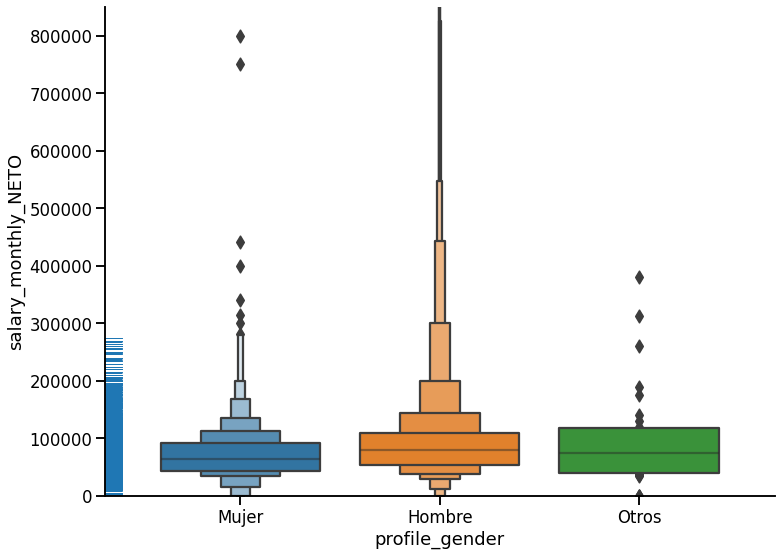

In [ ]:
# Graficando:
fig = plt.figure(figsize=(12, 9))
seaborn.boxenplot(data=df_ej2a, x='profile_gender', y='salary_monthly_NETO').set(ylim=(0,850000))
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()

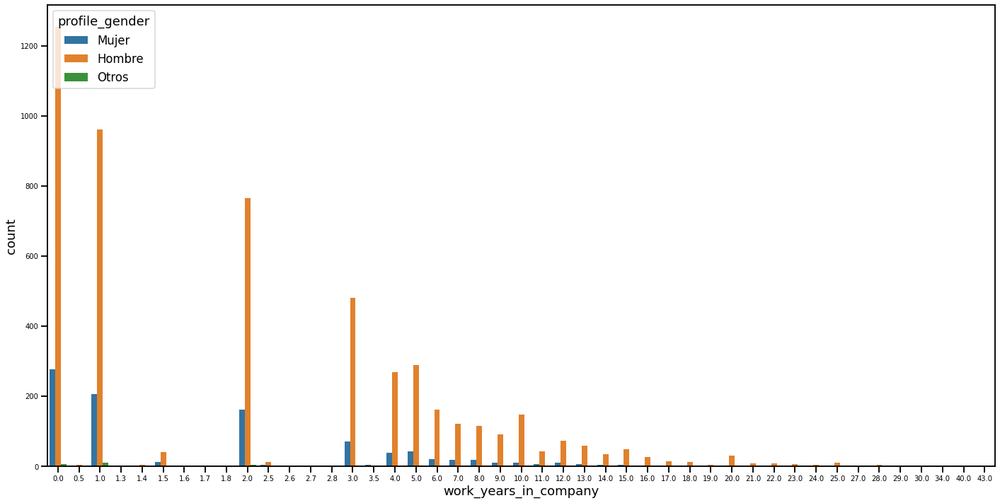

In [ ]:
fig = plt.figure(figsize=(24, 12))
seaborn.countplot(data=df_ej2a,x='work_years_in_company', hue='profile_gender').tick_params(labelsize=10, rotation=0)


In [ ]:
df_ej2a.profile_gender.describe()

count       6095
unique         3
top       Hombre
freq        5122
Name: profile_gender, dtype: object

Segun estos dos ultimos graficos podemos inferir que la media de salarios de los hombres es superior a la de mujeres y otras sexualidades y que suman la mayoria de la población.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


(0.0, 500000.0, 0.0, 1.0060977456943275e-05)

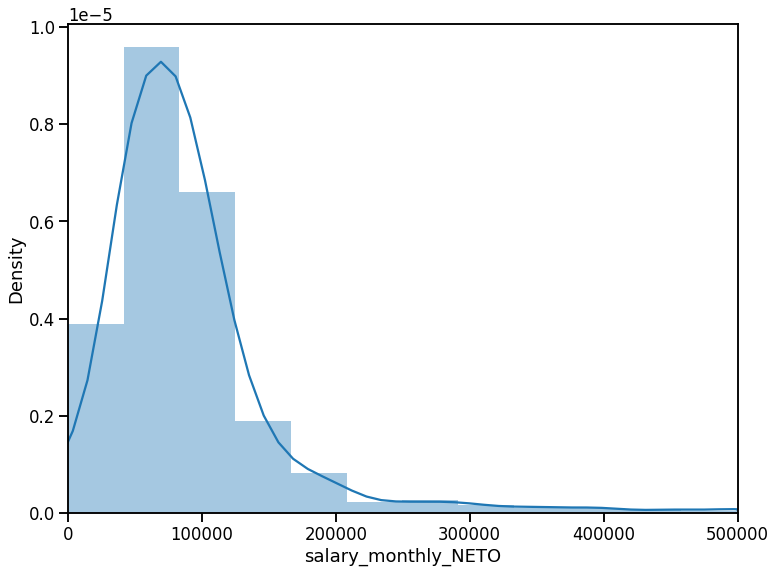

In [ ]:
f,ax=plt.subplots(figsize=(12, 9))
seaborn.distplot(df_ej2a['salary_monthly_NETO']).axis(xmin=0,xmax=500000)

## b) Asociación






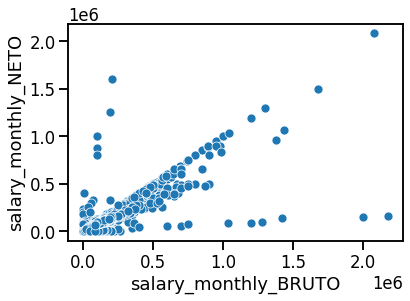

In [ ]:
df_asociacion = df
correlacion = seaborn.scatterplot(data = df_asociacion , x = 'salary_monthly_BRUTO', y = 'salary_monthly_NETO')


In [ ]:
df_asociacion[['salary_monthly_BRUTO', 'salary_monthly_NETO']].corr()

,salary_monthly_BRUTO,salary_monthly_NETO
salary_monthly_BRUTO,1.000000,0.833335
salary_monthly_NETO,0.833335,1.000000


Este resulado de correlación lineal entre las variables en estudio cuyo valor es 0.833335 nos indica que hay una asociación fuerte entre las variables.

# **En base a este resultado, y ubicandose el resultado del coeficiente de correlacion de Pearson muy cerca de 1, consideramos que podría sacarse la columna de salario bruto**

## c) Densidad condicional 

Estudie la distribución del salario según el nivel de estudio.

Separe la población según el nivel de estudio (elija dos subpoblaciones numerosas) y grafique de manera comparativa ambos histogramas de la variable `'salary_monthly_NETO'`
¿Considera que ambas variables son independientes?
¿Qué analizaría al respecto?

Calcule medidas de centralización y dispersión para cada subpoblación






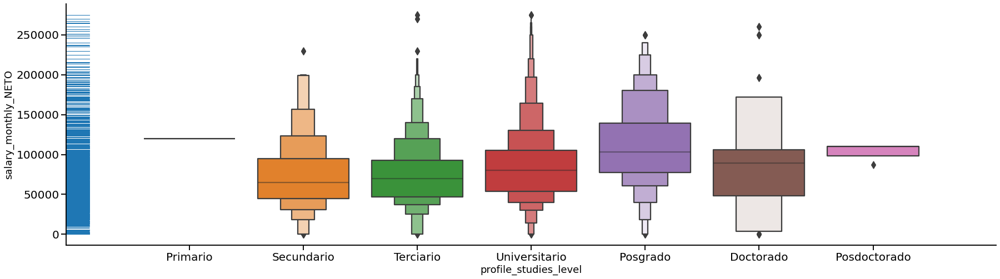

In [ ]:
# Graficando:
fig = plt.figure(figsize=(30, 8))
orden=['Primario', 'Secundario', 'Terciario', 'Universitario', 'Posgrado','Doctorado','Posdoctorado']
seaborn.boxenplot(data= clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), x='profile_studies_level', y='salary_monthly_NETO', order = orden).tick_params(labelsize=20, rotation=0)
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()

In [ ]:
import plotly.express as px

clean_df =  df.loc[
  (df['profile_studies_level'] =='Secundario') | 
  (df['profile_studies_level'] == 'Terciario') |
  (df['profile_studies_level'] == 'Universitario') |
  (df['profile_studies_level'] == 'Posgrado') |
  (df['profile_studies_level'] == 'Doctorado')
]

fig = px.box(clean_outliers_q3(clean_df, 
  'salary_monthly_NETO'), 
  x='profile_studies_level', 
  y='salary_monthly_NETO', 
  points="all", 
  color="profile_studies_level",
  title="Salario neto por nivel de estudios",
  labels={
    "salary_monthly_NETO": "Sueldo neto mensual",  "profile_studies_level": "Nivel de estudios"
  },
  category_orders={
    "profile_studies_level": ["Secundario", "Terciario", "Universitario", "Posgrado", "Doctorado"]
  },
  color_discrete_map={
    "Secundario": "#f72585",
    "Terciario": "#b5179e",
    "Universitario": "#7209b7",
    "Posgrado": "#3a0ca3",
    "Doctorado": "#3f37c9",
  },
  template="ggplot2",
  width=1200
)

fig.show()

In [ ]:
data_limpia = clean_outliers_q3(df_draft, 'salary_monthly_NETO')
data_limpia.groupby(by='profile_studies_level').describe()

salary_monthly_NETO                               \
                                    count           mean           std   
profile_studies_level                                                    
Doctorado                            52.0   89660.234423  71226.717647   
Posdoctorado                          3.0  102333.333333  13279.056191   
Posgrado                            414.0  110200.562729  52051.798983   
Primario                              2.0  120000.000000      0.000000   
Secundario                          509.0   73854.759917  45340.744676   
Terciario                          1648.0   74519.622973  40372.605418   
Universitario                      6074.0   84938.443789  45822.907715   

                                                                             \
                             min          25%       50%       75%       max   
profile_studies_level                                                         
Doctorado                  70.00   47861.3025   88950.0  106250.0  260000.0   
Posdoctorado            87000.00   98500.0000  110000.0  110000.0  110000.0   
Posgrado                   62.25   77100.0000  103000.0  139500.0  250000.0   
Primario               120000.00  120000.0000  120000.0  120000.0  120000.0   
Secundario                  1.00   45000.0000   64636.0   95000.0  230000.0   
Terciario                   1.00   47000.0000   70000.0   93000.0  275000.0   
Universitario              13.00   53951.0000   80000.0  105000.0  275000.0   

                      profile_years_experience                             \
                                         count       mean       std   min   
profile_studies_level                                                       
Doctorado                                 52.0  13.301923  9.474372   0.0   
Posdoctorado                               3.0  10.000000  8.660254   0.0   
Posgrado                                 414.0  12.280193  7.224437   0.0   
Primario                                   2.0  11.000000  0.000000  11.0   
Secundario                               509.0   7.629470  6.565311   0.0   
Terciario                               1648.0   8.276396  6.537424   0.0   
Universitario                           6074.0   7.908018  6.426337   0.0   

                                               
                        25%   50%   75%   max  
profile_studies_level                          
Doctorado               3.0  12.0  24.0  30.0  
Posdoctorado            7.5  15.0  15.0  15.0  
Posgrado                6.0  11.0  17.0  30.0  
Primario               11.0  11.0  11.0  11.0  
Secundario              2.0   5.0  12.0  30.0  
Terciario               3.0   7.0  12.0  30.0  
Universitario           3.0   6.0  12.0  30.0



Separe la población según el nivel de estudio (elija dos subpoblaciones numerosas) y grafique de manera comparativa ambos histogramas de la variable `'salary_monthly_NETO'`
¿Considera que ambas variables son independientes?
¿Qué analizaría al respecto?








In [ ]:
import plotly.express as px

fig = px.pie(df, values='salary_monthly_NETO', names='profile_studies_level', title='ESTUDIOS')
fig.show()

In [ ]:
# SELECCIONAREMOS UNIVERSITARIOS Y TERCIARIOS
univ_terc = df.loc[(df['profile_studies_level'] =='Universitario') | (df['profile_studies_level'] == 'Terciario')]
fig = px.pie(univ_terc, values='salary_monthly_NETO', names='profile_studies_level', title='UNIVERSITARIOS Y TERCIARIOS')
fig.show()


<Figure size 720x720 with 0 Axes>

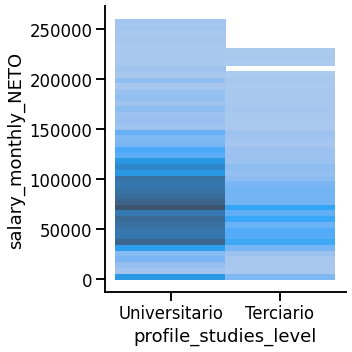

In [ ]:
fig = plt.figure(figsize=(10, 10))
seaborn.displot(data = clean_outliers_q3(univ_terc, 'salary_monthly_NETO')\
                  , x = 'profile_studies_level', y = 'salary_monthly_NETO')

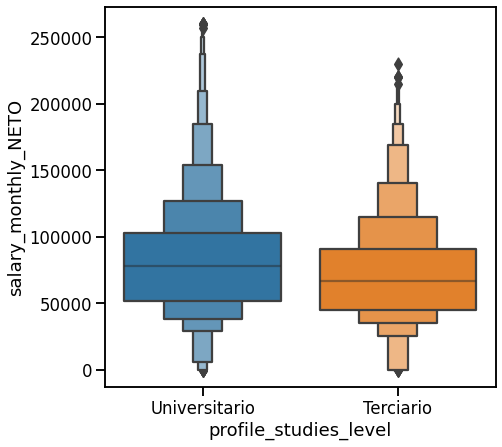

In [ ]:
fig = plt.figure(figsize=(7, 7))
seaborn.boxenplot(data = clean_outliers_q3(univ_terc, 'salary_monthly_NETO'), x = 'profile_studies_level', y = 'salary_monthly_NETO')

**Como se puede ver en el grafico anterior hay una diferencia sustancial en las medias de cada una de estas variables (en detrimento de Terciario) y de los quantiles superiores de Universitario. Se presume una dependencia entre nivel de estudios y salario mensual neto.**

**Medidas de centralización para cada subpoblación:**

In [ ]:
is_univ = df.profile_studies_level == 'Universitario'
univ = df[(df.salary_monthly_NETO > 1000) & is_univ].salary_monthly_NETO
univ_mean = univ.mean()
print("media salario mensual neto universitarios: ", univ_mean)

is_terciary = df.profile_studies_level == 'Terciario'
terciary = df[(df.salary_monthly_NETO > 1000) & is_terciary].salary_monthly_NETO
terciary_mean = terciary.mean()
print("media salario mensual neto Terciarios: ", terciary_mean)

media salario mensual neto universitarios:  100220.34150812066
media salario mensual neto Terciarios:  83922.52600938968


**Medidas de disperción para cada subpoblación:**

In [ ]:
univ_var = univ.var()
univ_std = univ.std()
univ_variation_coefficient = variation(univ, axis = 0)
univ_variation_coefficient2 = univ_std / univ_mean 
print("Varianza subpoblacion universitaria: ", univ_var)
print("Desvio standard subpoblacion universitaria: ", univ_std)
print("Coeficiente de variación subpoblacion universitaria: ", univ_variation_coefficient)

print("")

terciary_var = terciary.var()
terciary_std = terciary.std()
terciary_variation_coefficient = variation(terciary, axis = 0)
print("Varianza subpoblacion terciaria: ", terciary_var)
print("Desvio standard subpoblacion terciaria: ", terciary_std)
print("Coeficiente de variación subpoblacion terciarios: ", terciary_variation_coefficient)

Varianza subpoblacion universitaria:  9814191662.526545
Desvio standard subpoblacion universitaria:  99066.60215494697
Coeficiente de variación subpoblacion universitaria:  0.9883605487212659

Varianza subpoblacion terciaria:  5280343894.015629
Desvio standard subpoblacion terciaria:  72665.97480262429
Coeficiente de variación subpoblacion terciarios:  0.8654631213230993


## d) Densidad Conjunta condicional

Elija dos variables numéricas y una categórica. 
Estudie la dispersión (scatterplot) de las dos variables discriminando en color por la variable categórica (ayuda: hue en seaborn)


# **Variables elegidas:**

**Variables numéricas:** 


* 'salary_monthly_NETO'

* 'work_years_in_company'



**Variables categóricas:**

* 'profile_studies_level'





In [ ]:
fig = px.scatter(clean_outliers_q3(univ_terc, 'salary_monthly_NETO'), y="salary_monthly_NETO", x="work_years_in_company", color='profile_studies_level',
                 size='salary_monthly_NETO', hover_data=['profile_age'], size_max=30)
fig.show()

Se observa que a misma antigüedad en el puesto los perfiles con titulo universitario tendieron a ganar mas que sus pares con titulo terciario. A su vez, el grado de dispersión de los sueldos de universitarios fue mayor.

In [ ]:
df_asociacion_1= df_asociacion[(df_asociacion['profile_age']<64)]

In [ ]:
fig = px.scatter(df_asociacion_1, x="profile_age", y="salary_monthly_NETO", facet_col="profile_gender",
                 width=800, height=400)

fig.update_layout(
    margin=dict(l=30, r=20, t=20, b=20),
    paper_bgcolor="LightSteelBlue",
)

fig.show()

#GRAFICO MAPA

In [ ]:
url = (
    "https://raw.githubusercontent.com/python-visualization/folium/master/examples/data"
)
state_geo = f"{url}/us-states.json"
state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
state_data = pd.read_csv(state_unemployment)

m = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=state_geo,
    name="choropleth",
    data=state_data,
    columns=["State", "Unemployment"],
    key_on="feature.id",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m)

folium.LayerControl().add_to(m)

m

In [ ]:
#prov_geo = 'https://dnsg.ign.gob.ar/apps/api/v1/capas-sig/Geodesia+y+demarcaci%C3%B3n/L%C3%ADmites/linea_de_limite_070111/json'
# prov_geo = 'https://dnsg.ign.gob.ar/apps/api/v1/capas-sig/Geodesia+y+demarcaci%C3%B3n/L%C3%ADmites/provincia/json' 

#prov_geo = 'https://infra.datos.gob.ar/catalog/modernizacion/dataset/7/distribution/7.12/download/provincias.geojson'

In [ ]:
# We read the file and print it.
#geoJSON_df = gpd.read_file(prov_geo)
geoJSON_df = gpd.read_file('provincias.geojson')
geoJSON_df.sort_values('iso_nombre')


,nombre_completo,fuente,iso_id,nombre,id,categoria,iso_nombre,geometry
22,Provincia de Buenos Aires,IGN,AR-B,Buenos Aires,06,Provincia,Buenos Aires,POINT (-60.55883 -36.67694)
10,Provincia de Catamarca,IGN,AR-K,Catamarca,10,Provincia,Catamarca,POINT (-66.94768 -27.33583)
18,Provincia del Chaco,IGN,AR-H,Chaco,22,Provincia,Chaco,POINT (-60.76583 -26.38643)
6,Provincia del Chubut,IGN,AR-U,Chubut,26,Provincia,Chubut,POINT (-68.52676 -43.78862)
21,Ciudad Autónoma de Buenos Aires,IGN,AR-C,Ciudad Autónoma de Buenos Aires,02,Ciudad Autónoma,Ciudad Autónoma de Buenos Aires,POINT (-58.44586 -34.61449)
13,Provincia de Corrientes,IGN,AR-W,Corrientes,18,Provincia,Corrientes,POINT (-57.80122 -28.77430)
7,Provincia de Córdoba,IGN,AR-X,Córdoba,14,Provincia,Córdoba,POINT (-63.80175 -32.14293)
3,Provincia de Entre Ríos,IGN,AR-E,Entre Ríos,30,Provincia,Entre Ríos,POINT (-59.20145 -32.05887)
19,Provincia de Formosa,IGN,AR-P,Formosa,34,Provincia,Formosa,POINT (-59.93244 -24.89497)
20,Provincia de Jujuy,IGN,AR-Y,Jujuy,38,Provincia,Jujuy,POINT (-65.76425 -23.32008)


In [ ]:
df_provincias = clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO')
df_provincias.replace({'GBA':'Provincia de Buenos Aires'}, inplace=True)
df_provincias = df_provincias.groupby(by='work_province').mean('salary_monthly_NETO').reset_index()

In [ ]:
df_provincias.sort_values(by='work_province')

,work_province,index,salary_monthly_NETO,profile_years_experience
0,Catamarca,1588.600000,42480.000000,8.000000
1,Chaco,3342.978261,57262.130435,5.934783
2,Chubut,3710.936170,112287.234043,14.744681
3,Ciudad Autónoma de Buenos Aires,2861.589983,87640.665649,8.143203
4,Corrientes,2223.962963,79860.444444,9.333333
5,Córdoba,2827.762346,78837.962469,7.251389
6,Entre Ríos,3054.200000,76359.552476,7.823810
7,Formosa,3831.111111,59238.222222,7.666667
8,Jujuy,3387.166667,64986.651515,5.863636
9,La Pampa,5243.545455,38669.090909,6.363636


In [ ]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df['iso_nombre'],df_provincias['work_province'])
missing_states

array(['Buenos Aires'], dtype=object)

In [ ]:
geoJSON_df.iloc[22,6] = 'Provincia de Buenos Aires'

In [ ]:
missing_states = numpy.setdiff1d(geoJSON_df['iso_nombre'],df_provincias['work_province'])
missing_states

array([], dtype=object)

In [ ]:
geoJSON_df = geoJSON_df.rename(columns = {"iso_nombre":"work_province"})

In [ ]:
final_df = geoJSON_df.merge(df, on = "work_province")
final_df.head()

,nombre_completo,fuente,iso_id,nombre,id,categoria,work_province,geometry,profile_gender,profile_age,...,profile_sexual_orientation,profile_has_disabilities,profile_has_disabilities_hiring_difficulties,company_employee_number,company_main_activity,company_recommended,company_diversity_policies,company_extra_benefits,company_best_companies_city,cured_programming_languages
0,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,29,...,Heterosexual,NaN,NaN,101-200,Servicios / Consultoría de Software / Digital,5,6,"Capacitaciones y/o cursos, Horarios flexibles,...",NaN,"[javascript, php, sql]"
1,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,39,...,Heterosexual,NaN,No,51-100,Otras industrias,5,6,"Capacitaciones y/o cursos, Estacionamiento gra...",NaN,"[html, java, javascript, php, sql]"
2,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,31,...,Heterosexual,NaN,NaN,11-50,Producto basado en Software,7,5,Ninguna de las anteriores,NaN,"[javascript, php, sql, typescript]"
3,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,32,...,Heterosexual,NaN,NaN,1-10,Producto basado en Software,8,8,"Abono de Internet, Capacitaciones y/o cursos, ...","trabajo en relacion de dependencia, pero remot...","[bash/shell, css, html, javascript, python, ty..."
4,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,32,...,Heterosexual,NaN,NaN,11-50,Otras industrias,5,6,Ninguna de las anteriores,"ninguna, todo está politizado","[c++, c#]"


In [ ]:
# Initialize folium map.
sample_map = folium.Map(location=[-26.8083,-65.2176], zoom_start=4)
sample_map

In [ ]:
# Set up Choropleth map
folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['work_province','salary_monthly_NETO'],
key_on="feature.properties.work_province",
fill_color='YlGnBu',
fill_opacity=1,
line_opacity=0.2,
legend_name="wills",
smooth_factor=0,
Highlight= True,
line_color = "#0000",
name = "Wills",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(sample_map)

sample_map

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: ignored

In [ ]:
#INTENTO 2

geoJSON_df2 = gpd.read_file('/content/drive/MyDrive/GEOJSON/ProvinciasArgentina.geojson')
geoJSON_df2

ERROR:fiona._env:/content/drive/MyDrive/GEOJSON/ProvinciasArgentina.geojson: No such file or directory


DriverError: ignored

In [ ]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df2['nombre'],df_provincias['work_province'])
missing_states

NameError: ignored

In [ ]:
#geoJSON_df2.loc[geoJSON_df2['nombre'] == 'Buenos Aires'] = 'Provincia de Buenos Aires'
geoJSON_df2[geoJSON_df2['nombre'] == 'Capital Federal'] = 'Ciudad Autónoma de Buenos Aires'

TypeError: ignored

In [ ]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df2['nombre'],df_provincias['work_province'])
missing_states

array([], dtype=object)

In [ ]:
geoJSON_df2 = geoJSON_df2.rename(columns = {"nombre":"work_province"})

In [ ]:
final_df = geoJSON_df2.merge(df_provincias, on = "work_province")
final_df.head()

,work_province,geometry,index,salary_monthly_NETO,profile_years_experience
0,Tucumán,"POLYGON ((-66.20361 -26.62782, -66.04980 -26.6...",3095.224138,66665.172414,7.568966
1,Santiago del Estero,"POLYGON ((-64.42108 -26.28356, -65.03906 -27.8...",4476.750000,46143.583333,10.833333
2,Salta,"POLYGON ((-66.11572 -26.21459, -65.85205 -26.3...",3358.950000,58112.400000,6.850000
3,Jujuy,"POLYGON ((-67.22534 -23.69483, -66.47827 -24.2...",3387.166667,64986.651515,5.863636
4,Formosa,"POLYGON ((-62.35840 -24.08659, -58.40332 -26.8...",3831.111111,59238.222222,7.666667


In [ ]:
# Initialize folium map.
provincias_map = folium.Map(location=[-26.8083,-65.2176], zoom_start=4)

# Set up Choropleth map
folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['work_province','salary_monthly_NETO'],
key_on="feature.properties.work_province",
fill_color='YlGnBu',
fill_opacity=1,
line_opacity=0.2,
legend_name="Salario Neto Medio",
smooth_factor=0,
Highlight= True,
line_color = "#0000",
name = "Salario Neto Medio",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(provincias_map)

provincias_map

In [ ]:
provincias_map.save('mapa_export')